In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
sns.set_style('darkgrid')

%matplotlib inline

In [2]:
df = pd.read_csv('../data/Inspection.csv')
fp = "../data/base_map/geo_export_68048701-5e7b-45e0-ac1c-85b45c057d6d.shp"
map_data = gpd.read_file(fp)



## Map Just Manhattan

In [3]:
df = pd.read_csv('../data/Inspection.csv')
df['date'] = pd.to_datetime(df['INSPECTION DATE'])
df = df[df.BORO == 'Manhattan']
df.sort_values(['date'], ascending=False, inplace= True)
df_recent = df.groupby(['CAMIS'], sort=False).first()
df_recent = df_recent[df_recent['INSPECTION DATE'] != '1/1/1900']
STARBUCKS = df_recent['DBA'].str.contains('STARBUCKS', regex=False, na=False)
STARBUCKS = df_recent[STARBUCKS]
Sbucks = df_recent[df_recent.DBA == "Starbucks"]
STARBUCKS = pd.concat([STARBUCKS, Sbucks])
STARBUCKS.CUISINE.value_counts()
STARBUCKS.rename(columns = {'VIOLATION CODE':'CODE'}, inplace = True)
STARBUCKS['Dif_Score'] = ( STARBUCKS.SCORE - STARBUCKS.SCORE.mean())
no_NA = df_recent.loc[(df_recent.Longitude != 0) & (df_recent.Latitude != 0)]

gdf = gpd.GeoDataFrame(
    no_NA, geometry=gpd.points_from_xy(no_NA.Longitude, no_NA.Latitude)) 

Text(0.5, 1.0, 'New York City Restaurants')

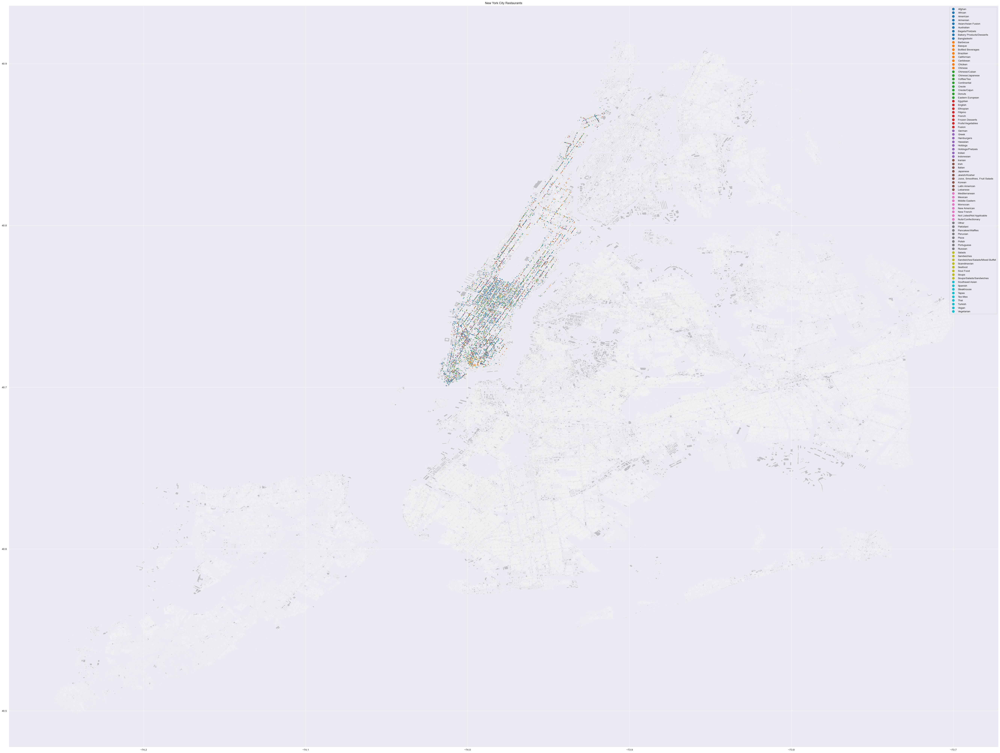

In [4]:
fig, ax = plt.subplots(figsize=(68, 80))

map_data.plot(ax=ax, color="grey", alpha=0.4)

gdf.plot('CUISINE', ax=ax, markersize=2, marker="o", legend= True)

plt.title("New York City Restaurants")


In [9]:
scaler.fit_transform(STARBUCKS[['SCORE']])

array([[-1.23027858],
       [-0.03399951],
       [-0.03399951],
       [-0.51251114],
       [-0.03399951],
       [-0.75176695],
       [ 0.44451212],
       [ 0.68376793],
       [ 1.16227956],
       [-0.03399951],
       [ 0.92302375],
       [ 0.92302375],
       [ 0.68376793],
       [-0.75176695],
       [-0.03399951],
       [-0.99102277],
       [ 2.83707026],
       [-0.03399951],
       [ 0.44451212],
       [-1.23027858],
       [ 0.2052563 ],
       [-0.27325532],
       [-1.23027858],
       [ 1.16227956],
       [-1.23027858],
       [ 1.16227956],
       [ 0.2052563 ],
       [ 3.5548377 ],
       [ 1.16227956],
       [-0.99102277],
       [-1.70879021],
       [-0.51251114],
       [ 1.40153537],
       [-1.23027858],
       [-0.75176695],
       [-1.23027858],
       [-0.03399951],
       [-1.23027858],
       [-0.99102277],
       [-0.75176695],
       [ 0.44451212],
       [ 1.16227956],
       [ 1.40153537],
       [ 0.44451212],
       [ 0.92302375],
       [ 1

In [30]:
DUNKIN = df_recent['DBA'].str.contains('DUNKIN', regex=False, na=False)
DUNKIN = df_recent[DUNKIN]

DUNKIN

,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE,INSPECTION DATE,ACTION,VIOLATION CODE,...,BIN,BBL,NTA,Location Point,Zip Codes,Community Districts,Borough Boundaries,City Council Districts,Police Precincts,date
CAMIS,,,,,,,,,,,,,,,,,,,,,
50094935,DUNKIN,Manhattan,2414,BROADWAY,10024.0,7324062445,Donuts,2/8/2023,Violations were cited in the following area(s).,06D,...,1033301.0,1.012360e+09,MN12,NaN,NaN,NaN,NaN,NaN,NaN,2023-02-08
50089246,DUNKIN' DONUTS/BASKIN ROBBINS,Manhattan,140,EAST 34 STREET,10016.0,2124812905,Donuts,2/6/2023,Violations were cited in the following area(s).,06C,...,1018508.0,1.008890e+09,MN20,NaN,NaN,NaN,NaN,NaN,NaN,2023-02-06
41502172,DUNKIN,Manhattan,19,RECTOR STREET,10006.0,2127858111,Donuts,2/3/2023,Violations were cited in the following area(s).,08A,...,1000794.0,1.000188e+09,MN25,NaN,NaN,NaN,NaN,NaN,NaN,2023-02-03
50001854,DUNKIN,Manhattan,2264,FREDERICK DOUGLASS BOULEVARD,NaN,6465978172,Donuts,2/2/2023,Violations were cited in the following area(s).,10B,...,NaN,1.000000e+00,None,NaN,NaN,NaN,NaN,NaN,NaN,2023-02-02
50012218,DUNKIN,Manhattan,90,BROAD STREET,10004.0,2124227991,Donuts,2/2/2023,Violations were cited in the following area(s).,06E,...,1000025.0,1.000100e+09,MN25,NaN,NaN,NaN,NaN,NaN,NaN,2023-02-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50109808,DUNKIN' DONUTS,Manhattan,595,10 AVENUE,10036.0,2013496000,Coffee/Tea,2/3/2022,Violations were cited in the following area(s).,10F,...,1079230.0,1.010720e+09,MN15,NaN,NaN,NaN,NaN,NaN,NaN,2022-02-03
50085910,DUNKIN’,Manhattan,210,WEST 38 STREET,10018.0,2123959280,American,1/14/2022,Violations were cited in the following area(s).,06A,...,1014460.0,1.007870e+09,MN17,NaN,NaN,NaN,NaN,NaN,NaN,2022-01-14
41649359,DUNKIN,Manhattan,2,PENNSYLVANIA PLAZA,10121.0,2126437083,Donuts,8/2/2019,Violations were cited in the following area(s).,10I,...,1083026.0,1.007810e+09,MN17,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-02


In [35]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

DUNKIN = df_recent['DBA'].str.contains('DUNKIN', regex=False, na=False)
DUNKIN = df_recent[DUNKIN]

SUBWAY = df_recent['DBA'].str.contains('SUBWAY', regex=False, na=False)
SUBWAY = df_recent[SUBWAY]

CHIPOTLE = df_recent['DBA'].str.contains('CHIPOTLE', regex=False, na=False)
CHIPOTLE = df_recent[CHIPOTLE]

MCDONALD = df_recent['DBA'].str.contains("MCDONALD'S", regex=False, na=False)
MCDONALD = df_recent[MCDONALD]


DUNKIN['Scaled_score'] = scaler.fit_transform(DUNKIN[['SCORE']])
SUBWAY['Scaled_score'] = scaler.fit_transform(SUBWAY[['SCORE']])
STARBUCKS['Scaled_score'] = scaler.fit_transform(STARBUCKS[['SCORE']])

Chains = pd.concat([DUNKIN, STARBUCKS, SUBWAY, CHIPOTLE, MCDONALD])


no_NA = Chains.loc[(Chains.Longitude != 0) & (Chains.Latitude != 0)]

gdf = gpd.GeoDataFrame(
    no_NA, geometry=gpd.points_from_xy(no_NA.Longitude, no_NA.Latitude)) 

C:\Users\logic_switch\AppData\Local\Temp\ipykernel_19624\736104670.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DUNKIN['Scaled_score'] = scaler.fit_transform(DUNKIN[['SCORE']])
C:\Users\logic_switch\AppData\Local\Temp\ipykernel_19624\736104670.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  SUBWAY['Scaled_score'] = scaler.fit_transform(SUBWAY[['SCORE']])


Text(0.5, 1.0, 'New York City Restaurants')

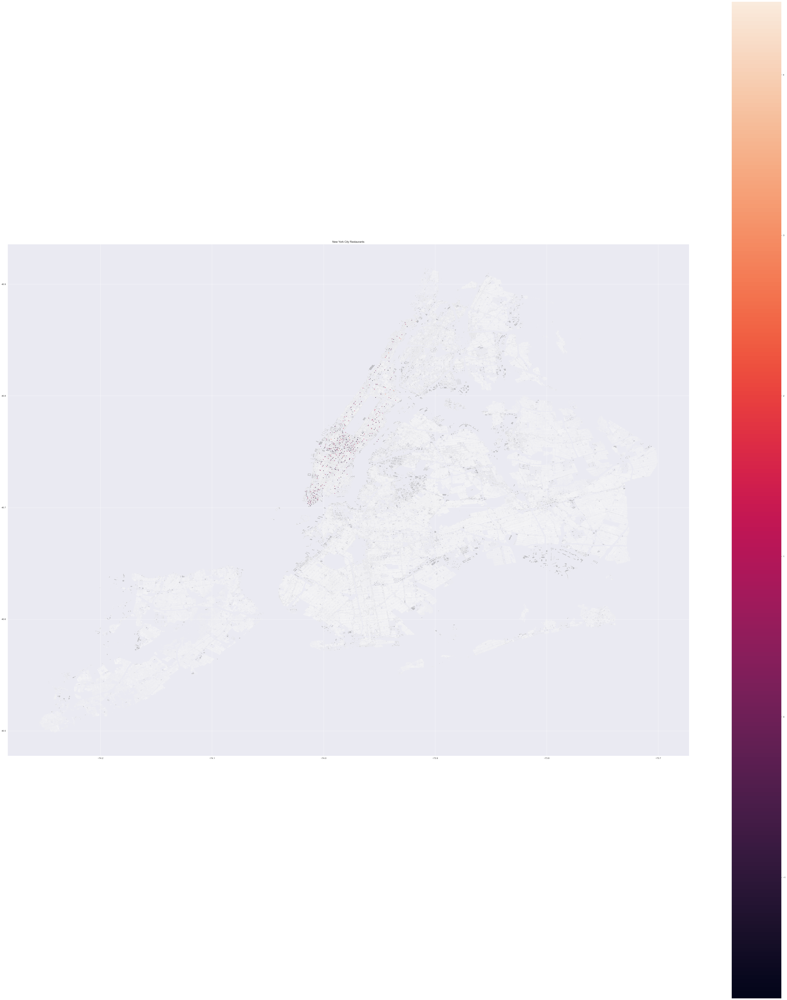

In [36]:
fig, ax = plt.subplots(figsize=(68, 80))

map_data.plot(ax=ax, color="grey", alpha=0.4)

gdf.plot('Scaled_score', ax=ax, markersize=2, marker="o", legend= True)

plt.title("New York City Restaurants")


7.1421052631578945
4.190669377334712


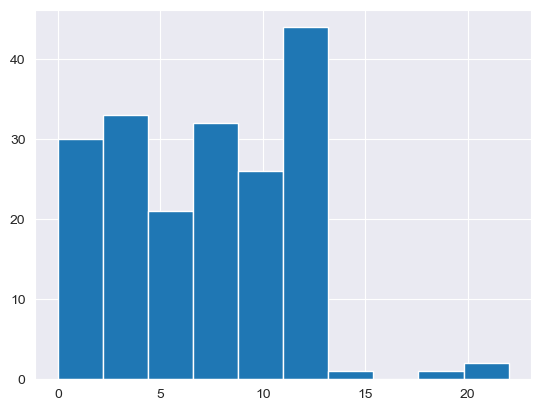

In [41]:
STARBUCKS = df_recent['DBA'].str.contains('STARBUCKS', regex=False, na=False)
STARBUCKS = df_recent[STARBUCKS]
Sbucks = df_recent[df_recent.DBA == "Starbucks"]
STARBUCKS = pd.concat([STARBUCKS, Sbucks])
STARBUCKS.CUISINE.value_counts()

print(STARBUCKS.SCORE.mean())
print(STARBUCKS.SCORE.std())
STARBUCKS.SCORE.hist()

Chains = pd.concat([ STARBUCKS])


no_NA = Chains.loc[(Chains.Longitude != 0) & (Chains.Latitude != 0)]

gdf = gpd.GeoDataFrame(
    no_NA, geometry=gpd.points_from_xy(no_NA.Longitude, no_NA.Latitude)) 

Text(0.5, 1.0, 'New York City Restaurants')

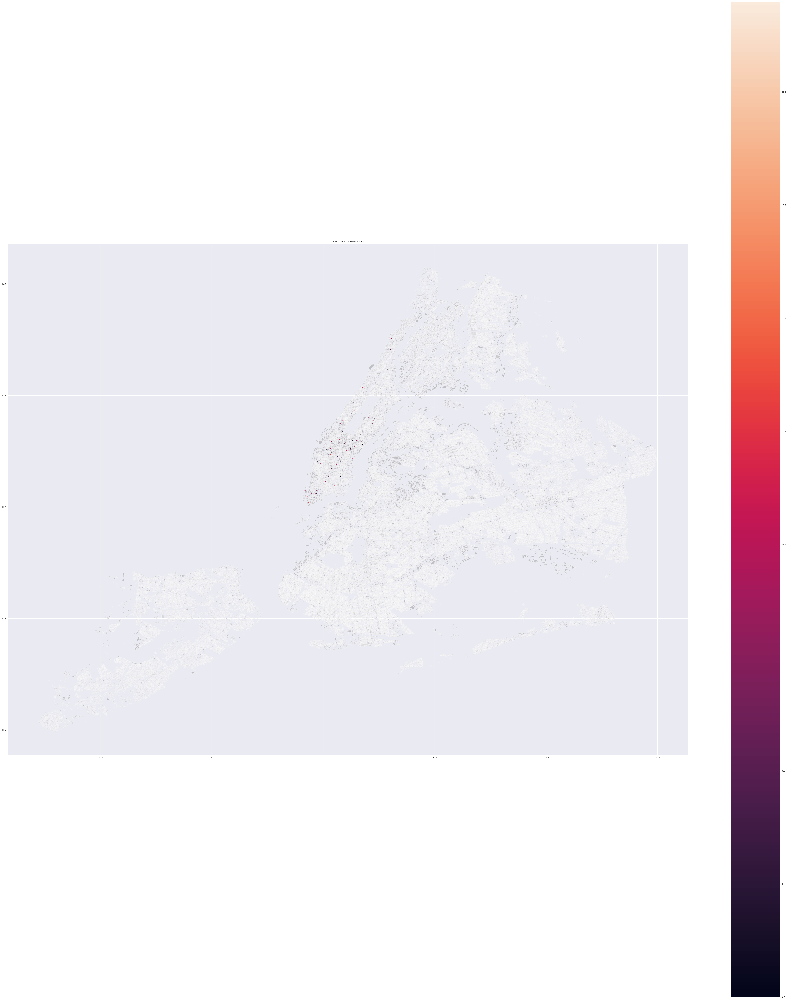

In [42]:
fig, ax = plt.subplots(figsize=(68, 80))

map_data.plot(ax=ax, color="grey", alpha=0.4)

gdf.plot('SCORE', ax=ax, markersize=2, marker="o", legend= True)

plt.title("New York City Restaurants")
